HSV y Máscara

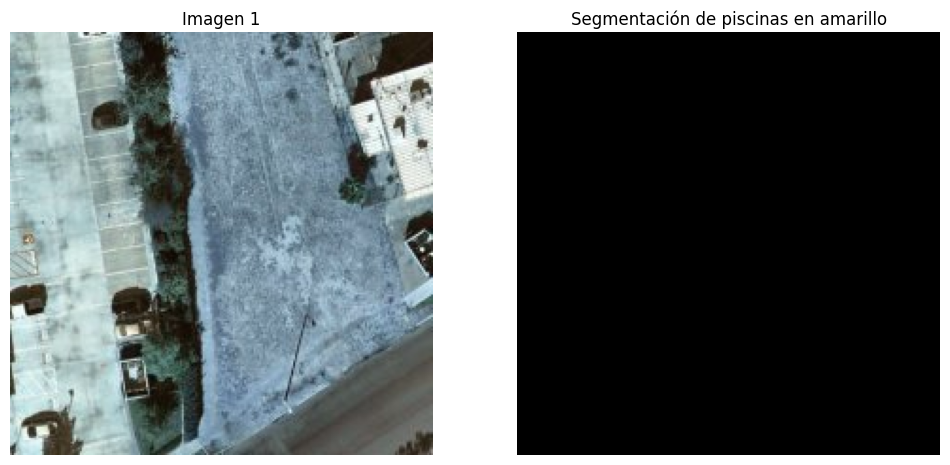

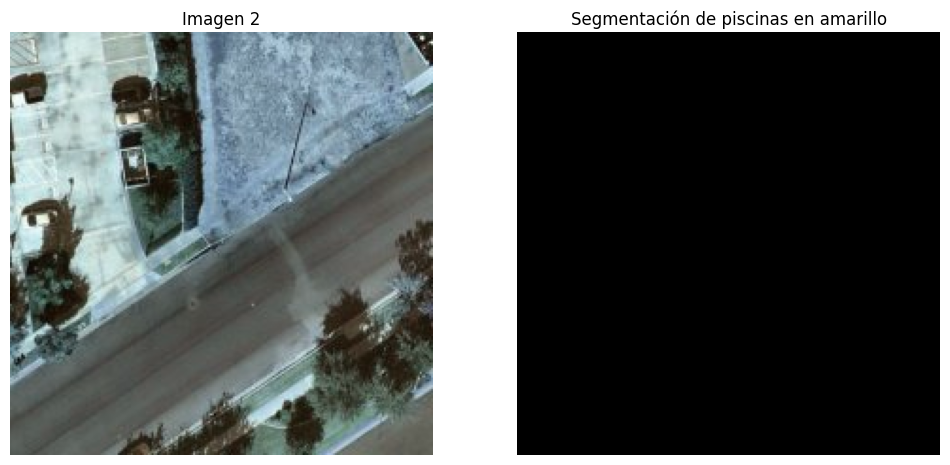

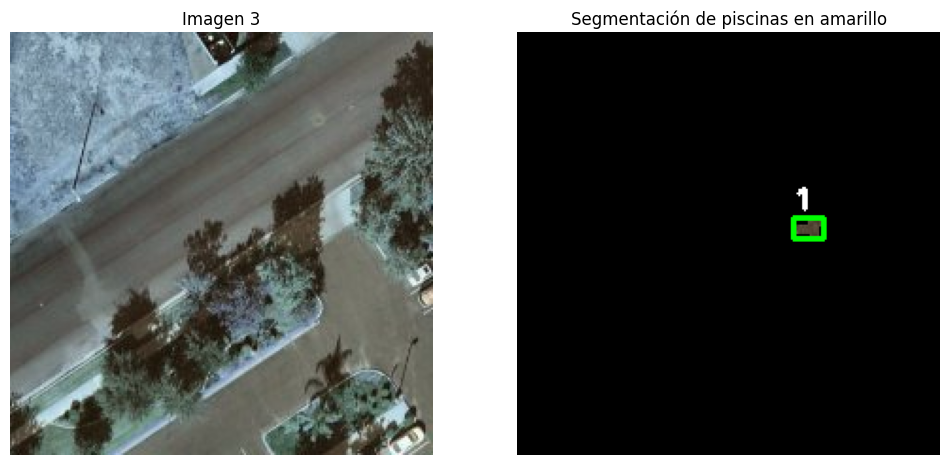

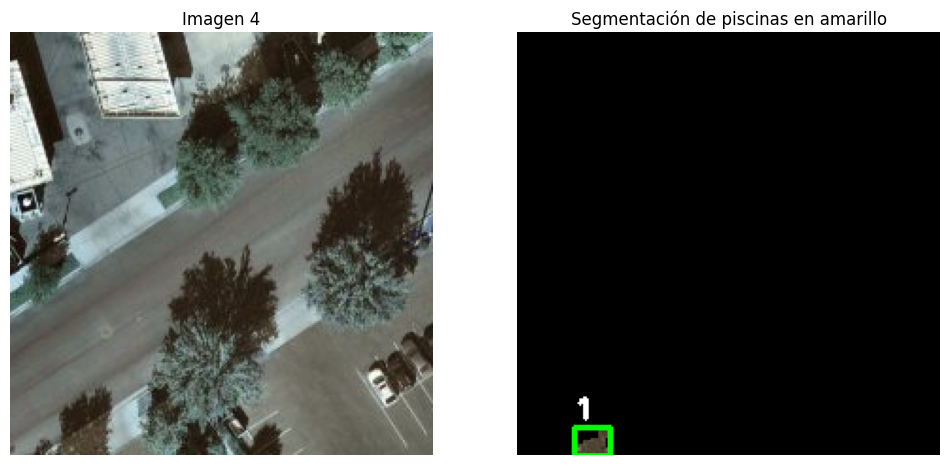

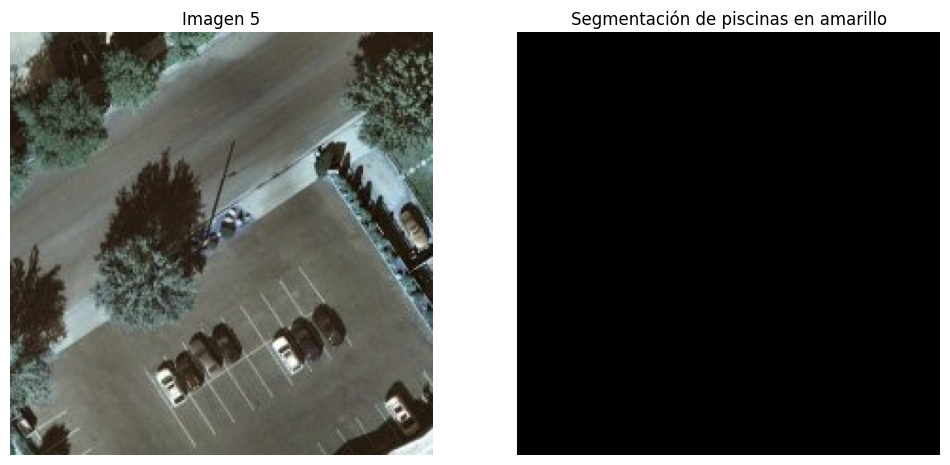

...

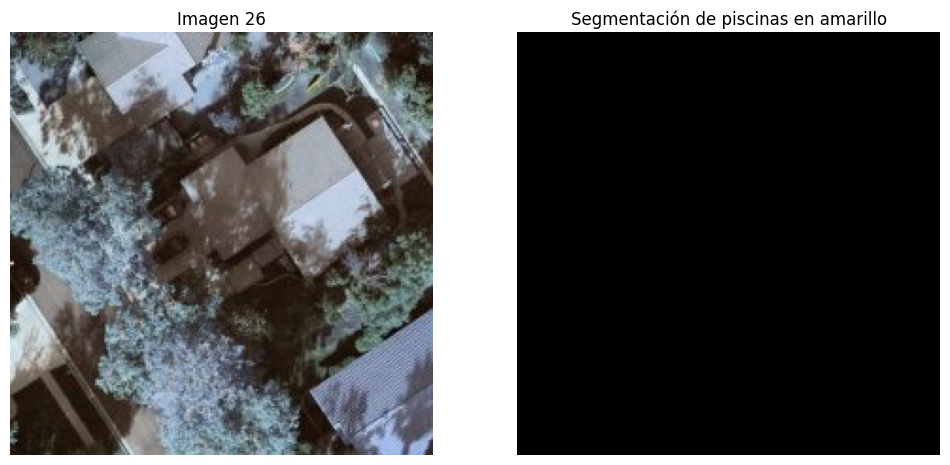

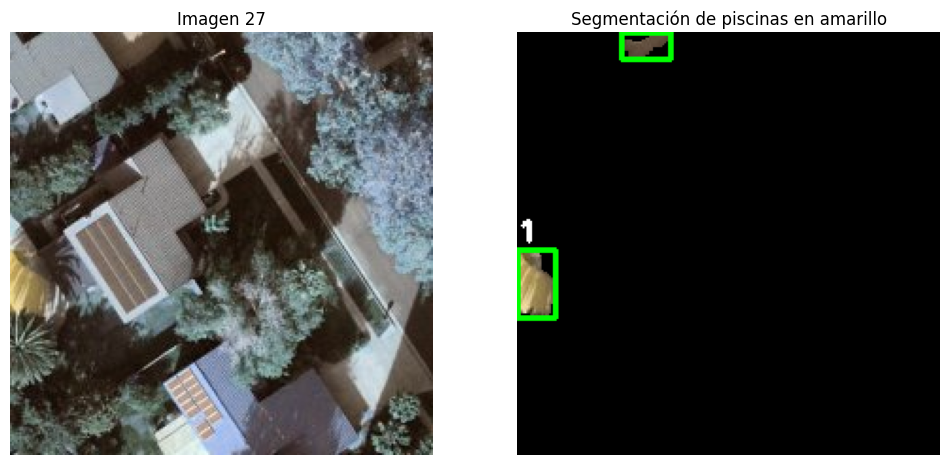

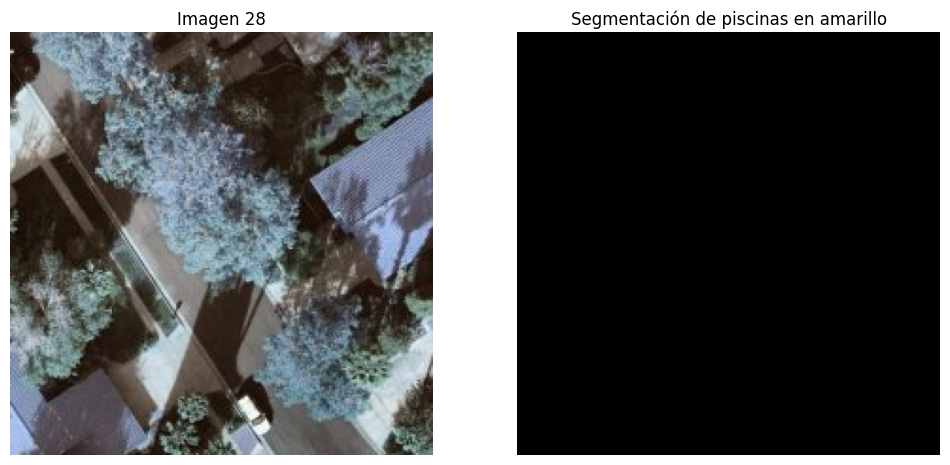

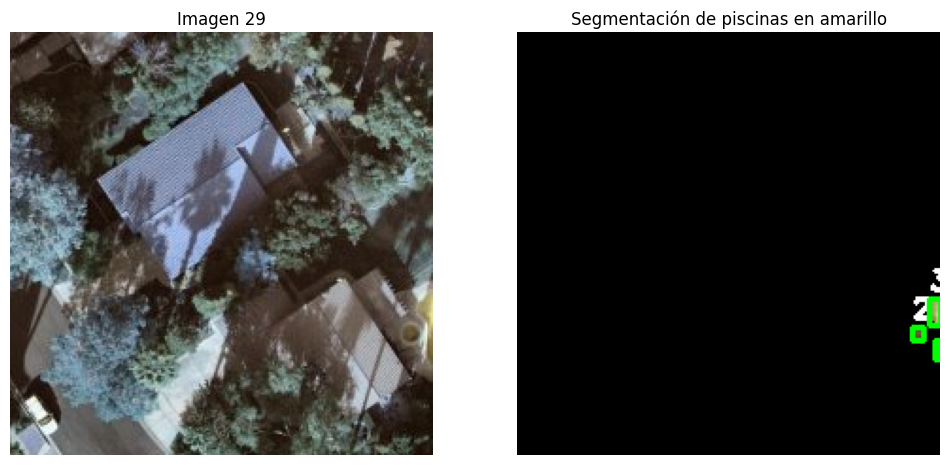

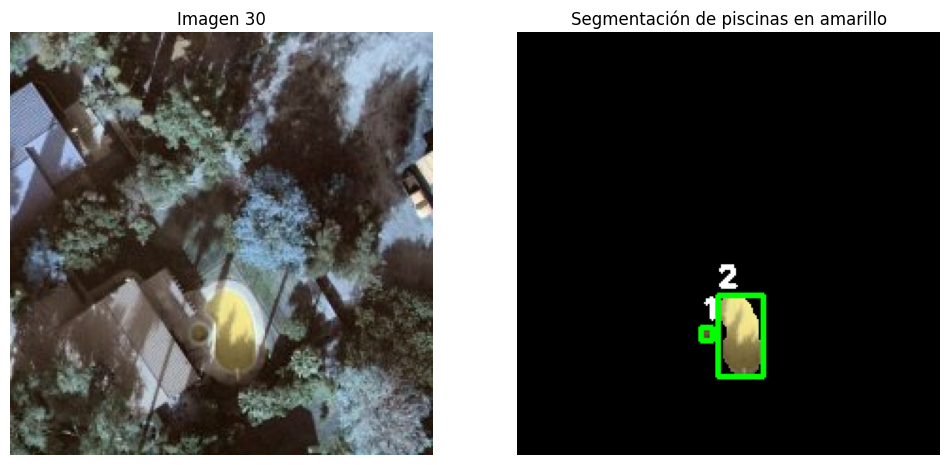

In [1]:
#NO BORRAR, PERO ESTE DETECTA DEMASIADAS COSAS 

import os
import skimage.io as io
import numpy as np
import cv2
import matplotlib.pyplot as plt

def load_images_from_files(file_list, directory):
    images = []
    for file in file_list:
        path = os.path.join(directory, file)
        image = io.imread(path)
        images.append(image)
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas
def draw_detected_pools(image, rectangles):
    for i, (x, y, w, h) in enumerate(rectangles, 1):
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image

# Visualizar resultados
def visualize_results(images):
    for i, img in enumerate(images):
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        image_with_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Visualizar resultados
        plt.figure(figsize=(12, 6))

        # Imagen original
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Imagen {i+1}")
        plt.axis('off')

        # Segmentación de áreas amarillas en la imagen original
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(image_with_boxes, cv2.COLOR_BGR2RGB))
        plt.title("Segmentación de piscinas en amarillo")
        plt.axis('off')

        plt.show()

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Obtener la lista de archivos de entrenamiento
train_files = os.listdir(train_dir)[:30]  # Utilizamos las primeras 30 imágenes para mostrar los resultados

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_files, train_dir)

# Visualizar segmentación de áreas amarillas para las primeras 30 imágenes
visualize_results(train_imgs)


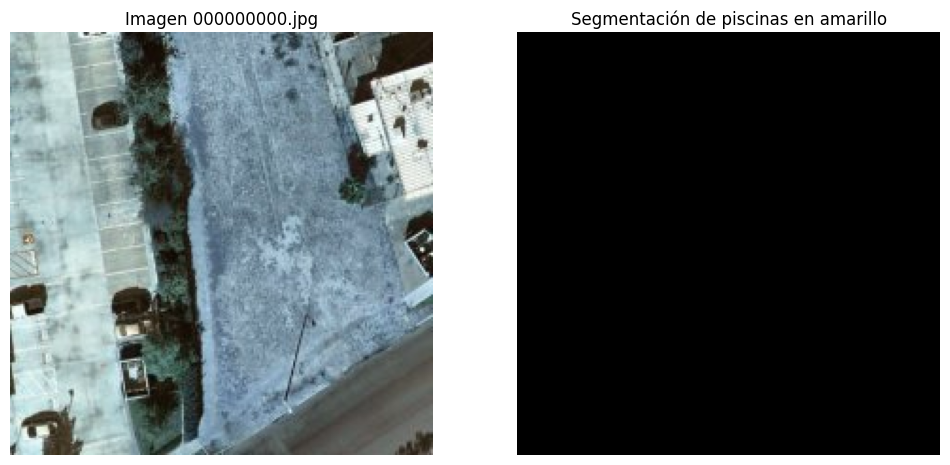

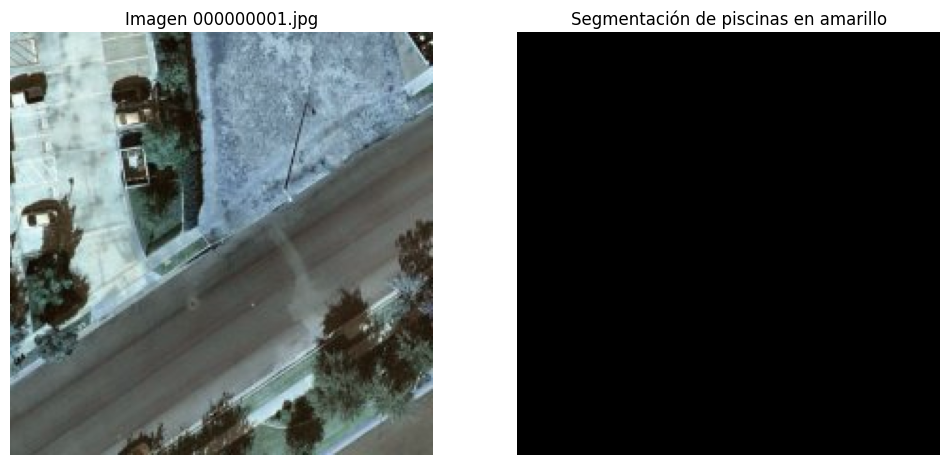

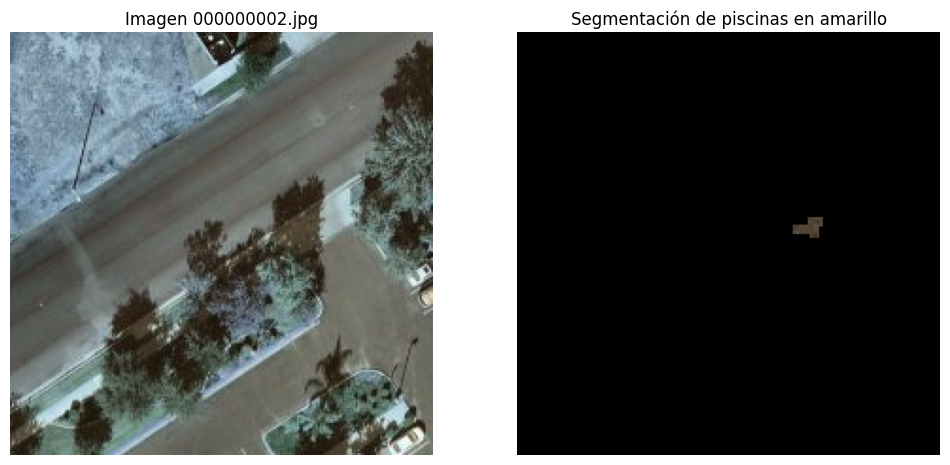

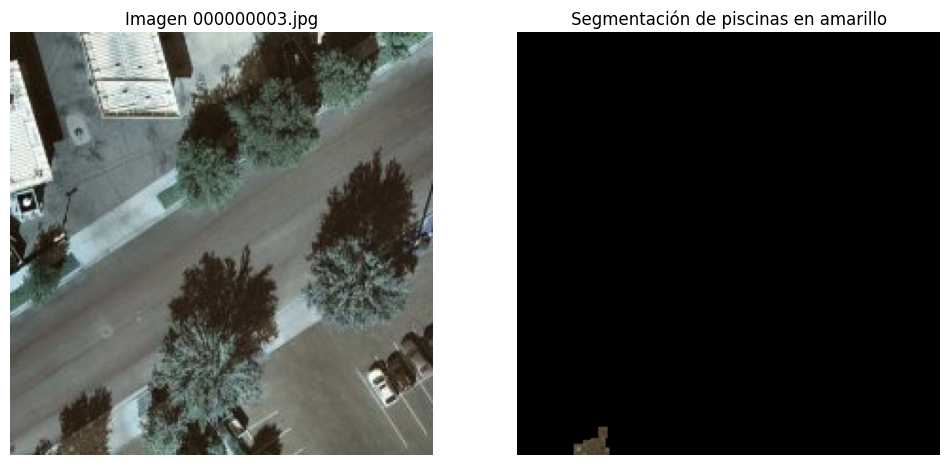

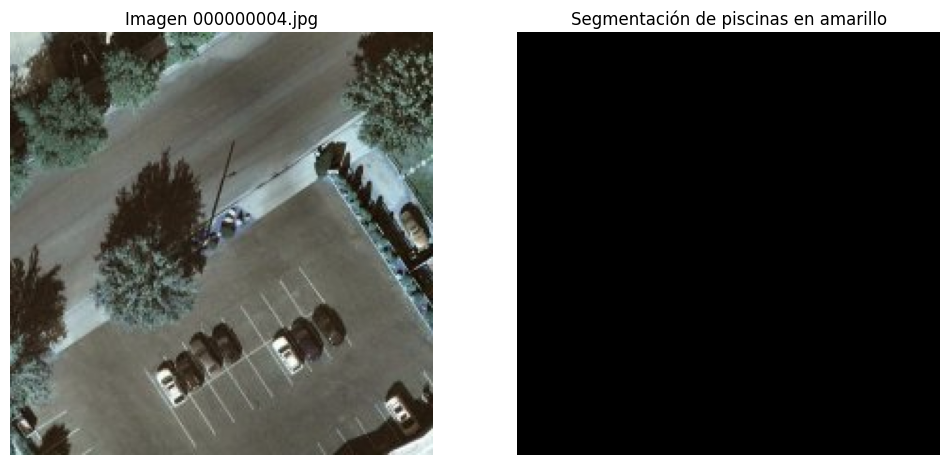

...

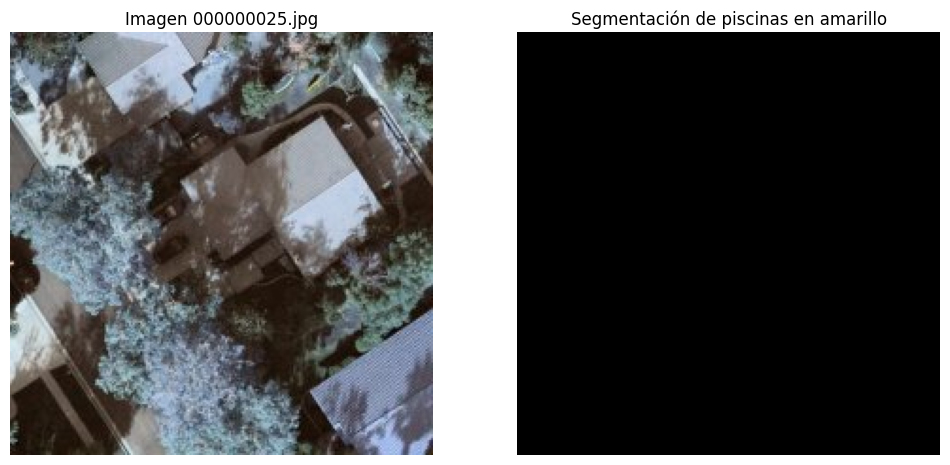

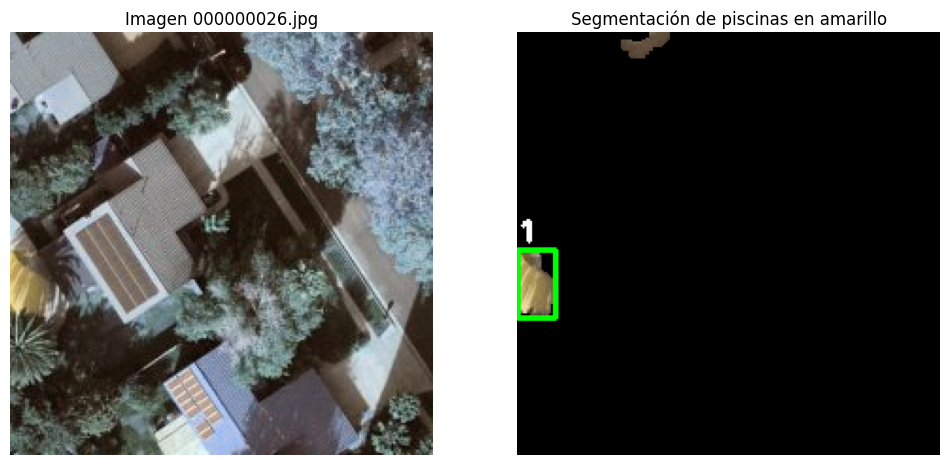

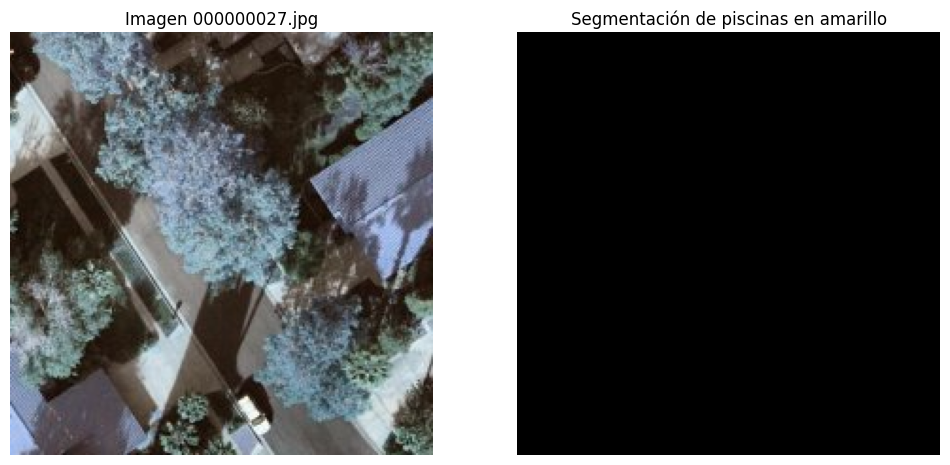

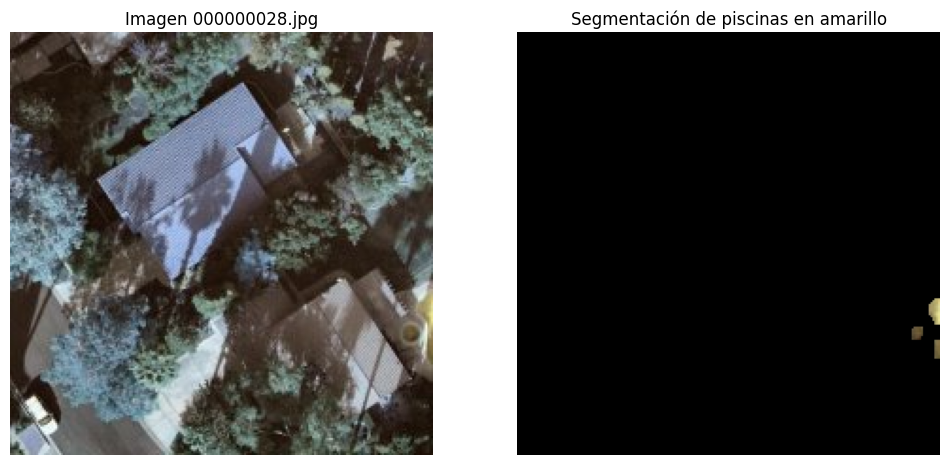

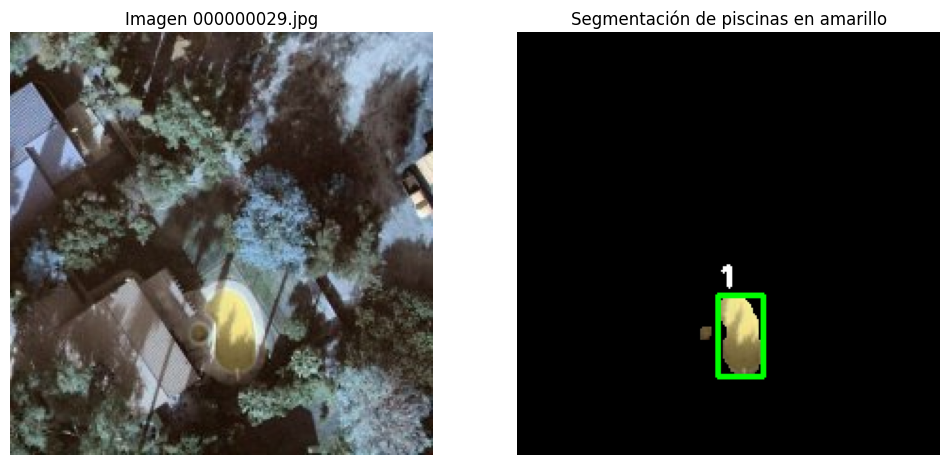

000000000.jpg: []
000000001.jpg: []
000000002.jpg: []
000000003.jpg: []
000000004.jpg: []
000000005.jpg: []
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(152, 199, 36, 25)]
000000013.jpg: [(40, 199, 36, 25)]
000000014.jpg: [(154, 180, 42, 44), (121, 105, 30, 35), (152, 87, 36, 26)]
000000015.jpg: [(42, 180, 42, 44), (98, 153, 38, 58), (9, 105, 30, 35), (40, 87, 36, 26)]
000000016.jpg: []
000000017.jpg: [(169, 95, 33, 43)]
000000018.jpg: [(0, 152, 24, 59)]
000000019.jpg: [(179, 0, 23, 26)]
000000020.jpg: [(135, 186, 23, 38), (57, 95, 33, 43)]
000000021.jpg: [(23, 186, 23, 38)]
000000022.jpg: [(151, 140, 36, 51), (208, 108, 16, 41), (134, 74, 24, 46), (67, 0, 23, 26)]
000000023.jpg: [(39, 140, 36, 51), (96, 108, 35, 43), (22, 74, 24, 46)]
000000024.jpg: []
000000025.jpg: []
000000026.jpg: [(0, 115, 20, 36)]
000000027.jpg: []
000000028.jpg: []
000000029.jpg: [(106, 139, 24, 43)]


In [5]:
#NO BORRAR PERO GUARDA MAL LAS COSAS

import os
import skimage.io as io
import numpy as np
import cv2
import matplotlib.pyplot as plt

def load_images_from_files(file_list, directory):
    images = []
    for file in file_list:
        path = os.path.join(directory, file)
        image = io.imread(path)
        images.append(image)
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas, eliminando las piscinas muy pequeñas
def draw_detected_pools(image, rectangles, min_area=500):
    filtered_rectangles = [rect for rect in rectangles if rect[2] * rect[3] > min_area]
    for i, (x, y, w, h) in enumerate(filtered_rectangles, 1):
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image

def visualize_results(images, file_list):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    for file, img in zip(file_list, images):
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas
        image_with_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Filtrar las bounding boxes que no se han dibujado
        filtered_rectangles = [rect for rect in rectangles if rect[2] * rect[3] > 500]  # Se utiliza el mismo criterio de área mínima que en draw_detected_pools

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = filtered_rectangles

        # Visualizar resultados
        plt.figure(figsize=(12, 6))

        # Imagen original
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Imagen {file}")
        plt.axis('off')

        # Segmentación de áreas amarillas en la imagen original
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(image_with_boxes, cv2.COLOR_BGR2RGB))
        plt.title("Segmentación de piscinas en amarillo")
        plt.axis('off')

        plt.show()

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Obtener la lista de archivos de entrenamiento
train_files = os.listdir(train_dir)[:30]  # Utilizamos las primeras 30 imágenes para mostrar los resultados

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_files, train_dir)

# Visualizar segmentación de áreas amarillas para las primeras 30 imágenes
pool_boxes = visualize_results(train_imgs, train_files)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")


In [2]:
#NO BORRAR ES EL BUENO

import os
import skimage.io as io
import numpy as np
import cv2

def load_images_from_files(directory):
    images = []
    for file in os.listdir(directory):
        if file.endswith('.jpg'):
            path = os.path.join(directory, file)
            image = io.imread(path)
            images.append((file, image))
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas, eliminando las piscinas muy pequeñas
def draw_detected_pools(image, rectangles, min_area=500):
    filtered_rectangles = [rect for rect in rectangles if rect[2] * rect[3] > min_area]
    bounding_boxes = []
    for i, (x, y, w, h) in enumerate(filtered_rectangles, 1):
        xmax = x + w
        ymax = y + h
        bounding_boxes.append((x, y, xmax, ymax))
        cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image, bounding_boxes

def visualize_results(images):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    for file, img in images:
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas y obtener las bounding boxes
        _, bounding_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = bounding_boxes

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_dir)

# Procesar todas las imágenes
pool_boxes = visualize_results(train_imgs)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")


000000000.jpg: []
000000001.jpg: []
000000002.jpg: []
000000003.jpg: []
000000004.jpg: []
000000005.jpg: []
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(152, 199, 188, 224)]
000000013.jpg: [(40, 199, 76, 224)]
000000014.jpg: [(154, 180, 196, 224), (121, 105, 151, 140), (152, 87, 188, 113)]
000000015.jpg: [(42, 180, 84, 224), (98, 153, 136, 211), (9, 105, 39, 140), (40, 87, 76, 113)]
000000016.jpg: []
000000017.jpg: [(169, 95, 202, 138)]
000000018.jpg: [(0, 152, 24, 211)]
000000019.jpg: [(179, 0, 202, 26)]
000000020.jpg: [(135, 186, 158, 224), (57, 95, 90, 138)]
000000021.jpg: [(23, 186, 46, 224)]
000000022.jpg: [(151, 140, 187, 191), (208, 108, 224, 149), (134, 74, 158, 120), (67, 0, 90, 26)]
000000023.jpg: [(39, 140, 75, 191), (96, 108, 131, 151), (22, 74, 46, 120)]
000000024.jpg: []
000000025.jpg: []
000000026.jpg: [(0, 115, 20, 151)]
000000027.jpg: []
000000028.jpg: []
000000029.jpg: [(106, 139, 130, 182

In [4]:
#NO BORRAR ES EL BUENO

import os
import cv2
import matplotlib.pyplot as plt

def load_images_from_files(directory):
    images = []
    for file in os.listdir(directory):
        if file.endswith('.jpg'):
            path = os.path.join(directory, file)
            image = io.imread(path)
            images.append((file, image))
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

def draw_detected_pools(image, rectangles, min_area=500):
    bounding_boxes = []
    for i, (x, y, w, h) in enumerate(rectangles, 1):
        # Comprobar si la bounding box contiene áreas amarillas claras
        hsv_img = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
        mask = cv2.inRange(hsv_img, (15, 100, 100), (40, 255, 255))  # Umbral para áreas amarillas claras
        if np.any(mask[y:y+h, x:x+w] == 255):
            xmax = x + w
            ymax = y + h
            bounding_boxes.append((x, y, xmax, ymax))
            cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
            cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
        else:
            if w * h > min_area:
                xmax = x + w
                ymax = y + h
                bounding_boxes.append((x, y, xmax, ymax))
                cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
                cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image, bounding_boxes

def visualize_results(images):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    file_list = [file for file, _ in images]
    for file, img in images:
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas
        image_with_boxes, all_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = all_boxes

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_dir)

# Procesar todas las imágenes
pool_boxes = visualize_results(train_imgs)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")


000000000.jpg: []
000000001.jpg: []
000000002.jpg: []
000000003.jpg: []
000000004.jpg: []
000000005.jpg: []
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(123, 217, 140, 224), (152, 199, 188, 224)]
000000013.jpg: [(11, 217, 28, 224), (40, 199, 76, 224)]
000000014.jpg: [(154, 180, 196, 224), (210, 154, 224, 186), (121, 105, 151, 140), (152, 87, 188, 113)]
000000015.jpg: [(42, 180, 84, 224), (98, 153, 136, 211), (9, 105, 39, 140), (40, 87, 76, 113)]
000000016.jpg: []
000000017.jpg: [(169, 95, 202, 138), (135, 3, 151, 29)]
000000018.jpg: [(0, 152, 24, 211)]
000000019.jpg: [(179, 0, 202, 26)]
000000020.jpg: [(214, 220, 220, 224), (135, 186, 158, 224), (57, 95, 90, 138), (23, 3, 39, 29)]
000000021.jpg: [(102, 220, 108, 224), (23, 186, 46, 224)]
000000022.jpg: [(151, 140, 187, 191), (208, 108, 224, 149), (134, 74, 158, 120), (67, 0, 90, 26)]
000000023.jpg: [(39, 140, 75, 191), (96, 108, 131, 151), (22, 74, 46, 120)

In [3]:
import os
import skimage.io as io
import numpy as np
import cv2

def load_images_from_files(directory):
    images = []
    for file in os.listdir(directory):
        if file.endswith('.jpg'):
            path = os.path.join(directory, file)
            image = io.imread(path)
            images.append((file, image))
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas, eliminando las piscinas muy pequeñas
def draw_detected_pools(image, rectangles):
    bounding_boxes = []
    for i, (x, y, w, h) in enumerate(rectangles, 1):
        xmax = x + w
        ymax = y + h
        bounding_boxes.append((x, y, xmax, ymax))
        cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image, bounding_boxes

def visualize_results(images):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    for file, img in images:
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas y obtener las bounding boxes
        _, bounding_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = bounding_boxes

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_dir)

# Procesar todas las imágenes
pool_boxes = visualize_results(train_imgs)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")

000000000.jpg: []
000000001.jpg: []
000000002.jpg: [(146, 98, 162, 109)]
000000003.jpg: [(30, 209, 49, 224)]
000000004.jpg: []
000000005.jpg: [(32, 97, 48, 113)]
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(123, 217, 140, 224), (152, 199, 188, 224)]
000000013.jpg: [(198, 220, 204, 224), (11, 217, 28, 224), (40, 199, 76, 224), (170, 134, 180, 144)]
000000014.jpg: [(154, 180, 196, 224), (210, 154, 224, 186), (121, 105, 151, 140), (152, 87, 188, 113)]
000000015.jpg: [(42, 180, 84, 224), (98, 153, 136, 211), (9, 105, 39, 140), (40, 87, 76, 113), (170, 22, 180, 32)]
000000016.jpg: [(86, 220, 92, 224), (58, 134, 68, 144)]
000000017.jpg: [(200, 204, 205, 210), (169, 95, 202, 138), (135, 3, 151, 29)]
000000018.jpg: [(0, 152, 24, 211), (58, 22, 68, 32)]
000000019.jpg: [(200, 92, 205, 98), (179, 0, 202, 26)]
000000020.jpg: [(214, 220, 220, 224), (88, 204, 93, 210), (135, 186, 158, 224), (57, 95, 90, 138), (23, 3, 39,

Canny

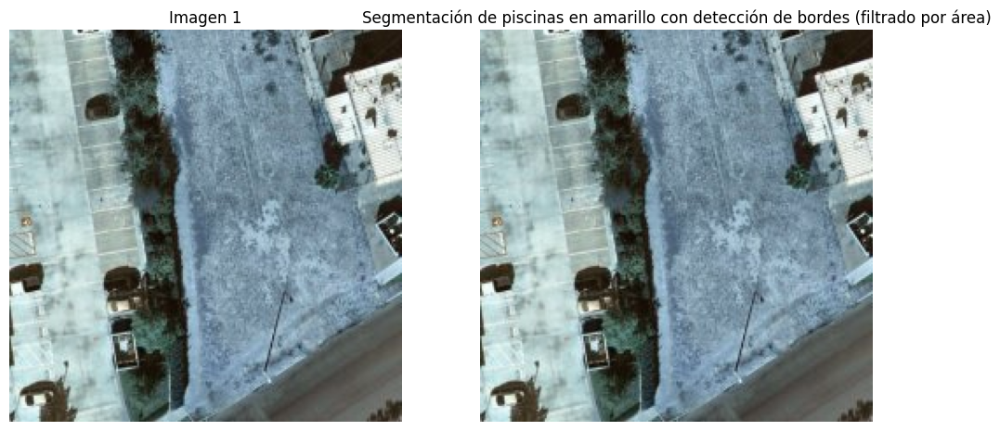

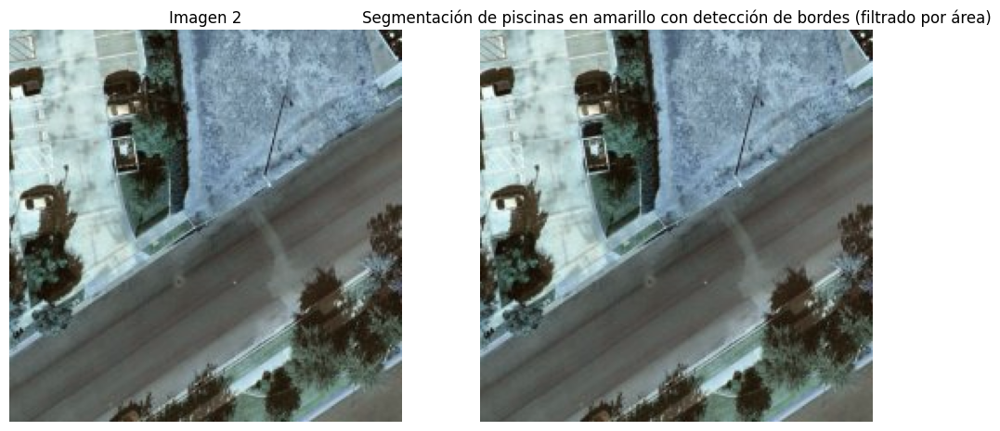

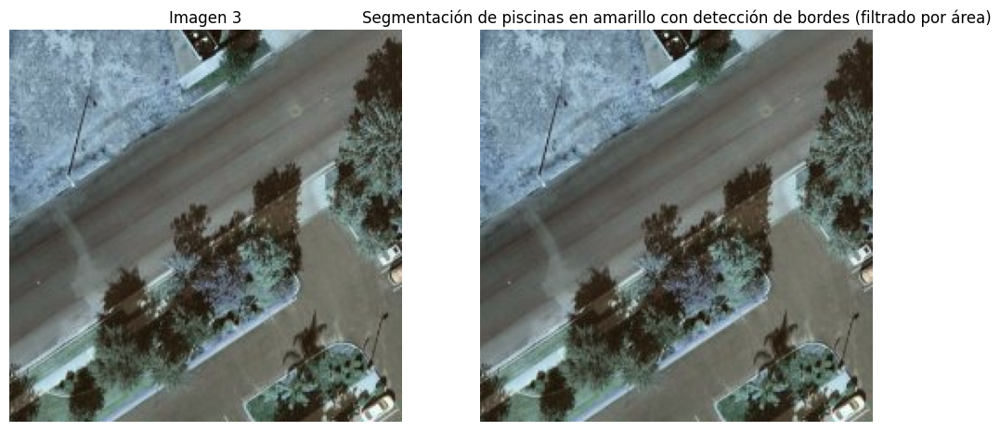

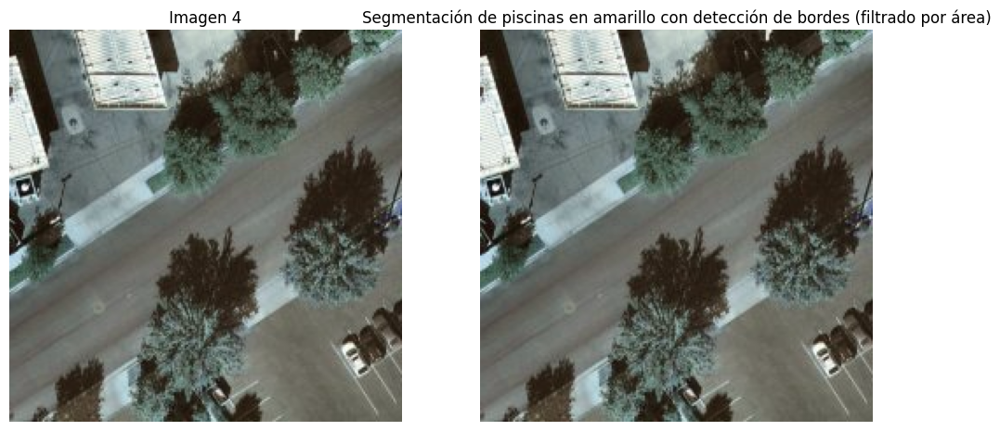

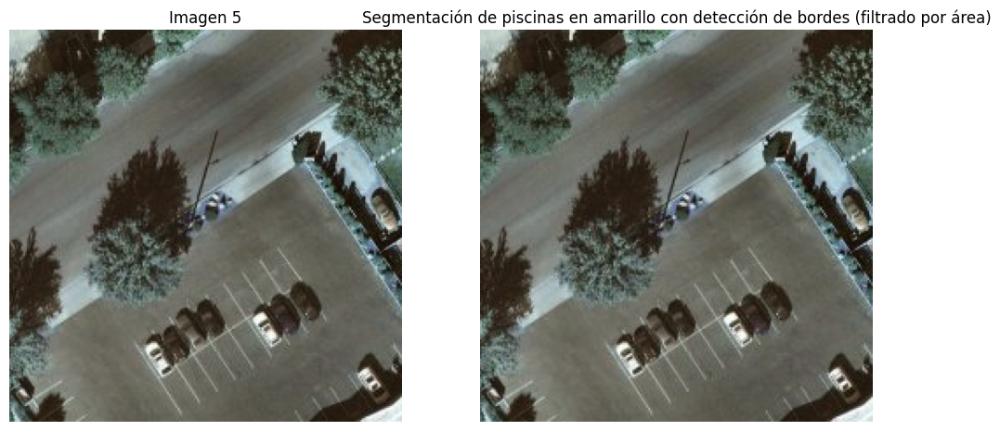

...

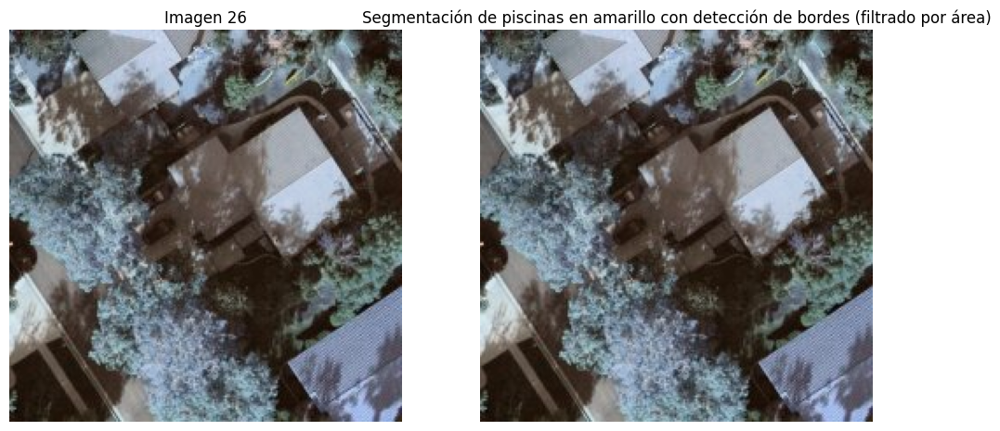

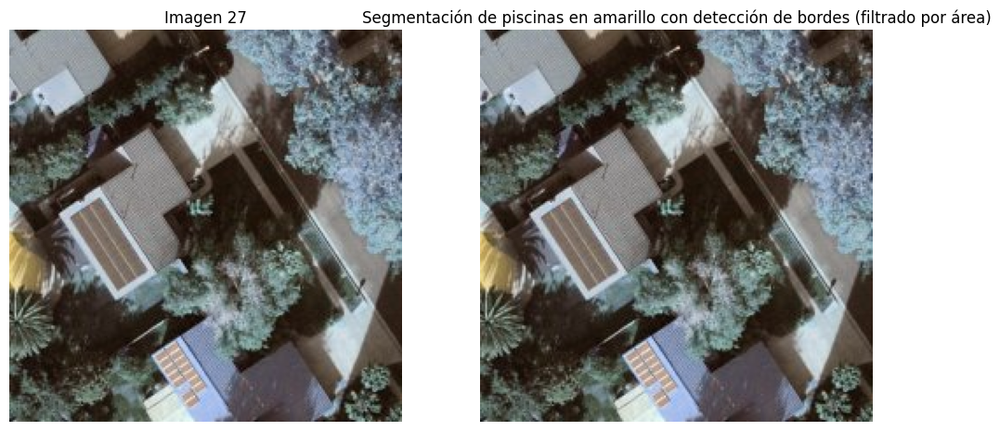

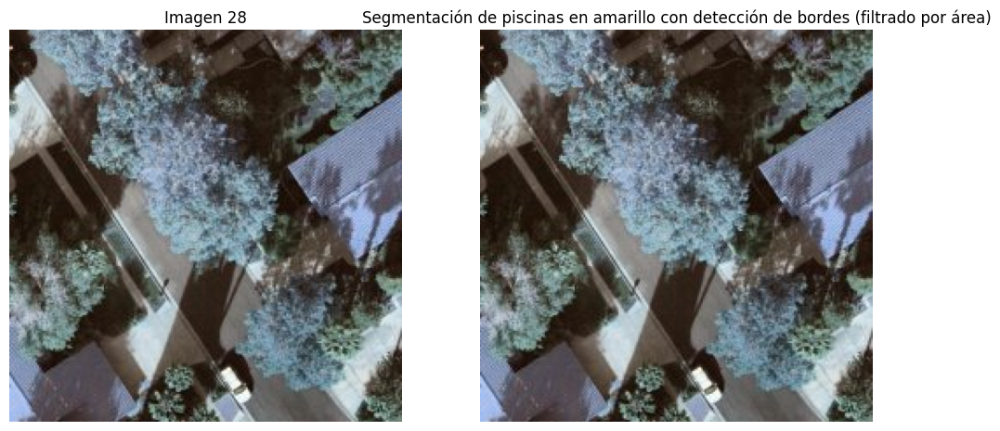

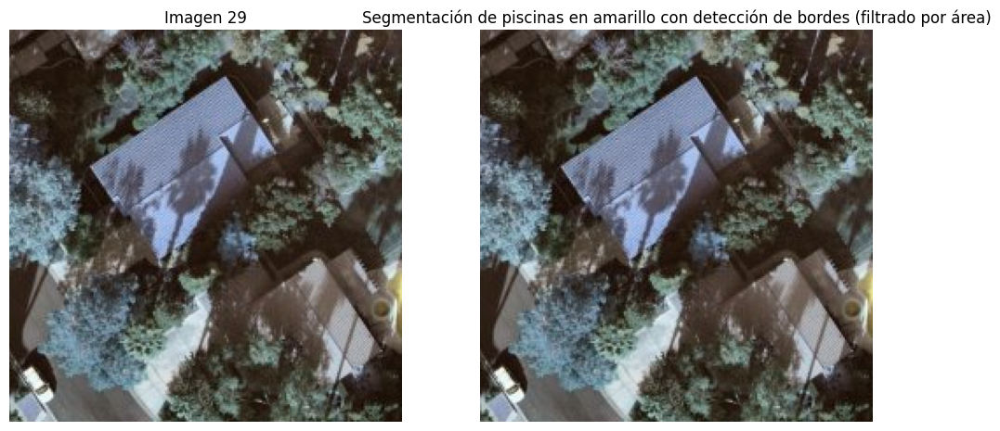

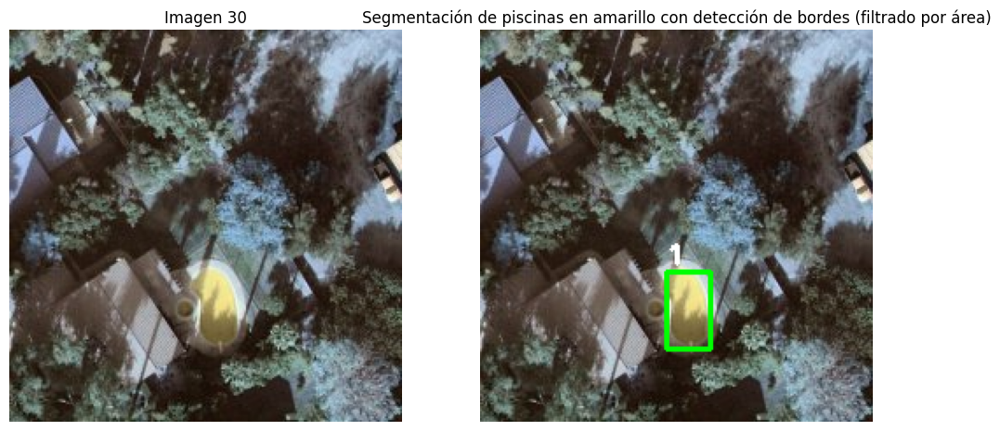

In [6]:
import os
import skimage.io as io
import numpy as np
import cv2
import matplotlib.pyplot as plt

def load_images_from_files(file_list, directory):
    images = []
    for file in file_list:
        path = os.path.join(directory, file)
        image = io.imread(path)
        images.append(image)
    return images

# Función para filtrar contornos por área
def filter_contours_by_area(contours, min_area):
    filtered_contours = []
    for contour in contours:
        if cv2.contourArea(contour) > min_area:
            filtered_contours.append(contour)
    return filtered_contours

# Función para segmentar las áreas amarillas y detectar piscinas usando Canny con filtrado de contornos por área
def segment_yellow_and_detect_pools(img, min_pool_area=500):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    # Canny
    edges = cv2.Canny(result, 100, 200)

    # Encontrar contornos en los bordes detectados
    contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Filtrar contornos por área
    contours = filter_contours_by_area(contours, min_pool_area)

    image_with_boxes = draw_detected_pools(img.copy(), contours)

    return image_with_boxes

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas
def draw_detected_pools(image, contours):
    for i, contour in enumerate(contours, 1):
        x, y, w, h = cv2.boundingRect(contour)
        cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image

# Visualizar resultados
def visualize_results(images):
    for i, img in enumerate(images):
        # Segmentación de áreas amarillas y detección de piscinas
        result_img = segment_yellow_and_detect_pools(img)

        # Visualizar resultados
        plt.figure(figsize=(12, 6))

        # Imagen original
        plt.subplot(1, 2, 1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f"Imagen {i+1}")
        plt.axis('off')

        # Segmentación de áreas amarillas y detección de piscinas
        plt.subplot(1, 2, 2)
        plt.imshow(cv2.cvtColor(result_img, cv2.COLOR_BGR2RGB))
        plt.title("Segmentación de piscinas en amarillo con detección de bordes (filtrado por área)")
        plt.axis('off')

        plt.show()

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Obtener la lista de archivos de entrenamiento
train_files = os.listdir(train_dir)[:30]  # Utilizamos las primeras 30 imágenes para mostrar los resultados

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_files, train_dir)

# Visualizar segmentación de áreas amarillas con detección de bordes (filtrado por área) para las primeras 30 imágenes
visualize_results(train_imgs)



In [1]:
#NO BORRAR ES EL BUENO

import os
import skimage.io as io
import numpy as np
import cv2

def load_images_from_files(directory):
    images = []
    for file in os.listdir(directory):
        if file.endswith('.jpg'):
            path = os.path.join(directory, file)
            image = io.imread(path)
            images.append((file, image))
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas, eliminando las piscinas muy pequeñas
def draw_detected_pools(image, rectangles, min_area=500):
    filtered_rectangles = [rect for rect in rectangles if rect[2] * rect[3] > min_area]
    bounding_boxes = []
    for i, (x, y, w, h) in enumerate(filtered_rectangles, 1):
        xmax = x + w
        ymax = y + h
        bounding_boxes.append((x, y, xmax, ymax))
        cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image, bounding_boxes

def visualize_results(images):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    for file, img in images:
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas y obtener las bounding boxes
        _, bounding_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = bounding_boxes

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_dir)

# Procesar todas las imágenes
pool_boxes = visualize_results(train_imgs)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")

000000000.jpg: []
000000001.jpg: []
000000002.jpg: []
000000003.jpg: []
000000004.jpg: []
000000005.jpg: []
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(152, 199, 188, 224)]
000000013.jpg: [(40, 199, 76, 224)]
000000014.jpg: [(154, 180, 196, 224), (121, 105, 151, 140), (152, 87, 188, 113)]
000000015.jpg: [(42, 180, 84, 224), (98, 153, 136, 211), (9, 105, 39, 140), (40, 87, 76, 113)]
000000016.jpg: []
000000017.jpg: [(169, 95, 202, 138)]
000000018.jpg: [(0, 152, 24, 211)]
000000019.jpg: [(179, 0, 202, 26)]
000000020.jpg: [(135, 186, 158, 224), (57, 95, 90, 138)]
000000021.jpg: [(23, 186, 46, 224)]
000000022.jpg: [(151, 140, 187, 191), (208, 108, 224, 149), (134, 74, 158, 120), (67, 0, 90, 26)]
000000023.jpg: [(39, 140, 75, 191), (96, 108, 131, 151), (22, 74, 46, 120)]
000000024.jpg: []
000000025.jpg: []
000000026.jpg: [(0, 115, 20, 151)]
000000027.jpg: []
000000028.jpg: []
000000029.jpg: [(106, 139, 130, 182

In [7]:
import os
import skimage.io as io
import numpy as np
import cv2

def load_images_from_files(directory):
    images = []
    for file in os.listdir(directory):
        if file.endswith('.jpg'):
            path = os.path.join(directory, file)
            image = io.imread(path)
            images.append((file, image))
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para detectar los bordes en la imagen utilizando el detector de bordes Canny
def detect_edges(img):
    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Aplicar el detector de bordes Canny
    edges = cv2.Canny(gray, 50, 150)

    return edges

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas detectadas
def draw_detected_pools(image, rectangles):
    bounding_boxes = []
    for i, (x, y, w, h) in enumerate(rectangles, 1):
        xmax = x + w
        ymax = y + h
        bounding_boxes.append((x, y, xmax, ymax))
        cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image, bounding_boxes

def visualize_results(images):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    for file, img in images:
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Detección de bordes utilizando el detector de bordes Canny
        edges = detect_edges(yellow_segmented_img_hsv)

        # Encontrar contornos en los bordes detectados
        contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas y obtener las bounding boxes
        _, bounding_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = bounding_boxes

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data/images/"

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_dir)

# Procesar todas las imágenes
pool_boxes = visualize_results(train_imgs)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")


000000000.jpg: []
000000001.jpg: []
000000002.jpg: [(146, 97, 162, 109)]
000000003.jpg: [(32, 220, 34, 222), (35, 218, 38, 224), (29, 209, 49, 224)]
000000004.jpg: []
000000005.jpg: [(31, 97, 49, 114)]
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(166, 220, 176, 224), (130, 219, 132, 224), (122, 216, 140, 224), (184, 215, 186, 219), (151, 198, 188, 224)]
000000013.jpg: [(198, 220, 204, 224), (54, 220, 64, 224), (18, 219, 20, 224), (10, 216, 28, 224), (72, 215, 74, 219), (39, 198, 76, 224), (170, 133, 181, 145)]
000000014.jpg: [(161, 200, 163, 203), (154, 179, 196, 224), (210, 153, 224, 187), (121, 104, 152, 140), (151, 86, 188, 114)]
000000015.jpg: [(49, 200, 51, 203), (42, 179, 84, 224), (98, 152, 137, 211), (9, 104, 40, 140), (39, 86, 76, 114), (170, 21, 181, 33)]
000000016.jpg: [(86, 220, 92, 224), (58, 133, 69, 145)]
000000017.jpg: [(199, 203, 206, 211), (168, 94, 203, 139), (147, 23, 149, 26), (134, 2, 

Con imagenes Wenpeng

In [3]:
#NO BORRAR ES EL BUENO

import os
import skimage.io as io
import numpy as np
import cv2

def load_images_from_files(directory):
    images = []
    for file in os.listdir(directory):
        if file.endswith('.jpg'):
            path = os.path.join(directory, file)
            image = io.imread(path)
            images.append((file, image))
    return images

# Función para segmentar las áreas amarillas en el espacio de color HSV
def segment_yellow_hsv(img):
    # Convertir la imagen a espacio de color HSV
    hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    # Definir los rangos de color para el amarillo en HSV
    lower_yellow = np.array([15, 80, 80])   # Umbral inferior para tono, saturación y valor
    upper_yellow = np.array([40, 255, 255]) # Umbral superior

    # Crear una máscara que identifique los píxeles que están dentro del rango de color amarillo
    mask = cv2.inRange(hsv, lower_yellow, upper_yellow)

    # Aplicar operaciones morfológicas para mejorar la segmentación
    kernel = np.ones((5, 5), np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel)
    mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    # Aplicar la máscara a la imagen original
    result = cv2.bitwise_and(img, img, mask=mask)

    return result

# Función para dibujar los cuadrados delimitadores alrededor de las piscinas, eliminando las piscinas muy pequeñas
def draw_detected_pools(image, rectangles, min_area=500):
    filtered_rectangles = [rect for rect in rectangles if rect[2] * rect[3] > min_area]
    bounding_boxes = []
    for i, (x, y, w, h) in enumerate(filtered_rectangles, 1):
        xmax = x + w
        ymax = y + h
        bounding_boxes.append((x, y, xmax, ymax))
        cv2.rectangle(image, (x, y), (xmax, ymax), (0, 255, 0), 2)
        cv2.putText(image, str(i), (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)
    return image, bounding_boxes

def visualize_results(images):
    pool_boxes = {}  # Diccionario para almacenar las bounding boxes de las piscinas detectadas en cada imagen
    for file, img in images:
        # Segmentación de áreas amarillas en el espacio de color HSV
        yellow_segmented_img_hsv = segment_yellow_hsv(img)

        # Obtener los contornos de las piscinas en la imagen segmentada
        contours, _ = cv2.findContours(cv2.cvtColor(yellow_segmented_img_hsv, cv2.COLOR_BGR2GRAY), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        rectangles = [cv2.boundingRect(contour) for contour in contours]

        # Dibujar los cuadrados verdes alrededor de las piscinas y obtener las bounding boxes
        _, bounding_boxes = draw_detected_pools(yellow_segmented_img_hsv.copy(), rectangles)

        # Actualizar el diccionario de bounding boxes de piscinas
        pool_boxes[file] = bounding_boxes

    return pool_boxes

# Directorio de archivos de entrenamiento
train_dir = "./DATABASE/training_data_modif/"

# Cargar imágenes de entrenamiento
train_imgs = load_images_from_files(train_dir)

# Procesar todas las imágenes
pool_boxes = visualize_results(train_imgs)

# Imprimir el diccionario de bounding boxes de piscinas
for file, boxes in pool_boxes.items():
    print(f"{file}: {boxes}")

000000000.jpg: []
000000001.jpg: []
000000002.jpg: []
000000003.jpg: []
000000004.jpg: []
000000005.jpg: []
000000006.jpg: []
000000007.jpg: []
000000008.jpg: []
000000009.jpg: []
000000010.jpg: []
000000011.jpg: []
000000012.jpg: [(150, 195, 186, 224)]
000000013.jpg: [(39, 194, 76, 224)]
000000014.jpg: [(156, 182, 197, 224), (119, 105, 150, 141), (149, 76, 185, 113)]
000000015.jpg: [(42, 182, 83, 215), (101, 153, 136, 209), (9, 105, 38, 139), (40, 85, 76, 112)]
000000016.jpg: []
000000017.jpg: [(168, 95, 201, 136)]
000000018.jpg: [(0, 152, 24, 209)]
000000019.jpg: [(179, 0, 202, 25)]
000000020.jpg: [(64, 94, 89, 136)]
000000021.jpg: [(23, 187, 43, 224)]
000000022.jpg: [(150, 140, 187, 198), (209, 109, 224, 148), (135, 74, 157, 119), (62, 0, 90, 26)]
000000023.jpg: [(38, 140, 75, 199), (97, 108, 131, 149)]
000000024.jpg: []
000000025.jpg: []
000000026.jpg: [(0, 115, 20, 148)]
000000027.jpg: []
000000028.jpg: []
000000029.jpg: [(108, 140, 128, 174)]
000000030.jpg: [(0, 139, 19, 182)]
00